In [553]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
sns.set_theme()

In [296]:
df=pd.read_csv("../data/dietary_composition_by_country.csv")

In [298]:
df.head()

,Entity,Code,Year,Miscellaneous group | 00002928 || Food available for consumption | 0664pc || kilocalories per day per capita,Alcoholic Beverages | 00002924 || Food available for consumption | 0664pc || kilocalories per day per capita,Animal fats group | 00002946 || Food available for consumption | 0664pc || kilocalories per day per capita,Vegetable Oils | 00002914 || Food available for consumption | 0664pc || kilocalories per day per capita,Oilcrops | 00002913 || Food available for consumption | 0664pc || kilocalories per day per capita,Fish and seafood | 00002960 || Food available for consumption | 0664pc || kilocalories per day per capita,Sugar crops | 00002908 || Food available for consumption | 0664pc || kilocalories per day per capita,...,Milk | 00002948 || Food available for consumption | 0664pc || kilocalories per day per capita,Nuts | 00002551 || Food available for consumption | 0664pc || kilocalories per day per capita,Fruit | 00002919 || Food available for consumption | 0664pc || kilocalories per day per capita,Vegetables | 00002918 || Food available for consumption | 0664pc || kilocalories per day per capita,Pulses | 00002911 || Food available for consumption | 0664pc || kilocalories per day per capita,"Cereals, other | 00002520 || Food available for consumption | 0664pc || kilocalories per day per capita",Barley | 00002513 || Food available for consumption | 0664pc || kilocalories per day per capita,Maize | 00002514 || Food available for consumption | 0664pc || kilocalories per day per capita,Rice | 00002807 || Food available for consumption | 0664pc || kilocalories per day per capita,Wheat | 00002511 || Food available for consumption | 0664pc || kilocalories per day per capita
0,Afghanistan,AFG,1961,0.0,0.0,45.673584,25.266237,16.520233,0.0,NaN,...,95.234280,1.486821,58.306700,21.379124,15.548454,0.0,230.04909,369.27580,202.97534,1640.6534
1,Afghanistan,AFG,1962,0.0,0.0,45.688790,30.135159,16.525732,0.0,NaN,...,94.293884,2.517744,52.493504,21.386242,16.525732,0.0,225.39154,361.79688,198.86288,1587.7632
2,Afghanistan,AFG,1963,0.0,0.0,48.623310,36.953716,16.531925,0.0,NaN,...,103.081410,0.661277,54.458107,22.366722,16.531925,0.0,220.70120,360.97946,193.97783,1360.2177
3,Afghanistan,AFG,1964,0.0,0.0,49.611140,32.101326,16.537048,0.0,NaN,...,103.113360,1.118683,69.066490,23.346420,17.509815,0.0,217.25789,357.02512,229.19376,1558.0331
4,Afghanistan,AFG,1965,0.0,0.0,51.569145,32.109090,16.541046,0.0,NaN,...,110.922310,2.091956,69.083190,23.352066,17.514050,0.0,212.45515,349.14255,223.99496,1563.4500


#### Umbennung der Spalten

In [301]:
df.columns=[col.split("|")[0].strip().replace(" ","_") for col in df.columns]

In [303]:
df.columns

Index(['Entity', 'Code', 'Year', 'Miscellaneous_group', 'Alcoholic_Beverages',
       'Animal_fats_group', 'Vegetable_Oils', 'Oilcrops', 'Fish_and_seafood',
       'Sugar_crops', 'Sugar_&_Sweeteners', 'Starchy_Roots', 'Meat,_Other',
       'Meat,_sheep_and_goat', 'Meat,_pig', 'Meat,_poultry',
       'Meat,_beef_and_buffalo', 'Eggs', 'Milk', 'Nuts', 'Fruit', 'Vegetables',
       'Pulses', 'Cereals,_other', 'Barley', 'Maize', 'Rice', 'Wheat'],
      dtype='object')

In [305]:
df.head()

,Entity,Code,Year,Miscellaneous_group,Alcoholic_Beverages,Animal_fats_group,Vegetable_Oils,Oilcrops,Fish_and_seafood,Sugar_crops,...,Milk,Nuts,Fruit,Vegetables,Pulses,"Cereals,_other",Barley,Maize,Rice,Wheat
0,Afghanistan,AFG,1961,0.0,0.0,45.673584,25.266237,16.520233,0.0,NaN,...,95.234280,1.486821,58.306700,21.379124,15.548454,0.0,230.04909,369.27580,202.97534,1640.6534
1,Afghanistan,AFG,1962,0.0,0.0,45.688790,30.135159,16.525732,0.0,NaN,...,94.293884,2.517744,52.493504,21.386242,16.525732,0.0,225.39154,361.79688,198.86288,1587.7632
2,Afghanistan,AFG,1963,0.0,0.0,48.623310,36.953716,16.531925,0.0,NaN,...,103.081410,0.661277,54.458107,22.366722,16.531925,0.0,220.70120,360.97946,193.97783,1360.2177
3,Afghanistan,AFG,1964,0.0,0.0,49.611140,32.101326,16.537048,0.0,NaN,...,103.113360,1.118683,69.066490,23.346420,17.509815,0.0,217.25789,357.02512,229.19376,1558.0331
4,Afghanistan,AFG,1965,0.0,0.0,51.569145,32.109090,16.541046,0.0,NaN,...,110.922310,2.091956,69.083190,23.352066,17.514050,0.0,212.45515,349.14255,223.99496,1563.4500


In [307]:
# Ergänzen der total calorie supply (Summe ab Spalte 4)
df["total"] = df.iloc[:, 4:].sum(axis=1)


In [309]:
df.head()

,Entity,Code,Year,Miscellaneous_group,Alcoholic_Beverages,Animal_fats_group,Vegetable_Oils,Oilcrops,Fish_and_seafood,Sugar_crops,...,Nuts,Fruit,Vegetables,Pulses,"Cereals,_other",Barley,Maize,Rice,Wheat,total
0,Afghanistan,AFG,1961,0.0,0.0,45.673584,25.266237,16.520233,0.0,NaN,...,1.486821,58.306700,21.379124,15.548454,0.0,230.04909,369.27580,202.97534,1640.6534,2886.356663
1,Afghanistan,AFG,1962,0.0,0.0,45.688790,30.135159,16.525732,0.0,NaN,...,2.517744,52.493504,21.386242,16.525732,0.0,225.39154,361.79688,198.86288,1587.7632,2808.635677
2,Afghanistan,AFG,1963,0.0,0.0,48.623310,36.953716,16.531925,0.0,NaN,...,0.661277,54.458107,22.366722,16.531925,0.0,220.70120,360.97946,193.97783,1360.2177,2595.842970
3,Afghanistan,AFG,1964,0.0,0.0,49.611140,32.101326,16.537048,0.0,NaN,...,1.118683,69.066490,23.346420,17.509815,0.0,217.25789,357.02512,229.19376,1558.0331,2845.247695
4,Afghanistan,AFG,1965,0.0,0.0,51.569145,32.109090,16.541046,0.0,NaN,...,2.091956,69.083190,23.352066,17.514050,0.0,212.45515,349.14255,223.99496,1563.4500,2847.044912


In [99]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12877 entries, 0 to 12876
Data columns (total 29 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Entity                  12877 non-null  object 
 1   Code                    10216 non-null  object 
 2   Year                    12877 non-null  int64  
 3   Miscellaneous_group     12702 non-null  float64
 4   Alcoholic_Beverages     12812 non-null  float64
 5   Animal_fats_group       12877 non-null  float64
 6   Vegetable_Oils          12877 non-null  float64
 7   Oilcrops                12802 non-null  float64
 8   Fish_and_seafood        12876 non-null  float64
 9   Sugar_crops             6175 non-null   float64
 10  Sugar_&_Sweeteners      12877 non-null  float64
 11  Starchy_Roots           12877 non-null  float64
 12  Meat,_Other             12874 non-null  float64
 13  Meat,_sheep_and_goat    12877 non-null  float64
 14  Meat,_pig               12598 non-null

In [311]:
df["Year"].unique()

array([1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971,
       1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982,
       1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993,
       1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004,
       2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015,
       2016, 2017, 2018, 2019, 2020, 2021, 2022], dtype=int64)

In [101]:
df.isnull().sum()

Entity                       0
Code                      2661
Year                         0
Miscellaneous_group        175
Alcoholic_Beverages         65
Animal_fats_group            0
Vegetable_Oils               0
Oilcrops                    75
Fish_and_seafood             1
Sugar_crops               6702
Sugar_&_Sweeteners           0
Starchy_Roots                0
Meat,_Other                  3
Meat,_sheep_and_goat         0
Meat,_pig                  279
Meat,_poultry                0
Meat,_beef_and_buffalo       0
Eggs                         0
Milk                         0
Nuts                        53
Fruit                        0
Vegetables                   0
Pulses                      18
Cereals,_other             173
Barley                     767
Maize                      177
Rice                         0
Wheat                        0
total                        0
dtype: int64

In [317]:
#sns.heatmap(df.isnull(),cbar=False)

In [319]:
df_stats=df.drop(["Entity","Code","Year"],axis=1).describe()   
df_stats

,Miscellaneous_group,Alcoholic_Beverages,Animal_fats_group,Vegetable_Oils,Oilcrops,Fish_and_seafood,Sugar_crops,Sugar_&_Sweeteners,Starchy_Roots,"Meat,_Other",...,Nuts,Fruit,Vegetables,Pulses,"Cereals,_other",Barley,Maize,Rice,Wheat,total
count,12702.000000,12812.000000,12877.000000,12877.000000,12802.000000,12876.000000,6175.000000,12877.000000,12877.000000,12874.000000,...,12824.000000,12877.000000,12877.000000,12859.000000,12704.000000,12110.000000,12700.000000,12877.00000,12877.000000,12877.000000
mean,6.740768,75.628594,78.992131,233.311846,57.061721,30.881050,4.054704,272.366367,174.554689,6.521292,...,11.416370,103.749144,51.602232,56.637098,13.501207,13.468453,173.692360,293.88880,494.034240,2510.892032
std,16.802630,69.398149,91.309841,139.302737,87.683642,31.756291,7.701505,150.450713,190.884176,15.141152,...,14.837303,77.121806,38.761081,48.342205,44.695229,40.721228,248.047462,347.43239,354.936142,581.824416
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,1.041707,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,455.340459
25%,0.000000,19.422774,16.920920,129.092740,15.000000,10.818416,0.000000,142.000000,57.296390,0.605078,...,1.247904,55.722040,22.538483,21.749237,0.161265,0.032892,19.948561,45.45072,210.804600,2081.757258
50%,1.052396,53.996496,43.144190,210.149110,33.925486,22.157155,1.000000,280.280640,116.951700,2.740000,...,5.513061,89.964460,41.797290,44.909355,2.612966,2.100539,72.677545,137.95000,436.331100,2529.797475
75%,5.754199,120.237588,103.930275,318.396100,62.693489,41.242294,5.154149,389.389280,199.067580,6.444944,...,16.295766,128.000000,71.000000,80.000000,8.879596,9.604951,222.144480,440.50000,706.313800,2974.823810
max,259.921660,473.902200,634.614750,785.815860,828.360000,370.602050,83.374620,726.995300,1445.136600,242.306580,...,189.248370,711.248840,308.493130,468.402980,770.498300,575.068400,1510.075900,2010.56730,1967.175400,4626.281365


In [339]:
mean=df_stats.loc["mean"].iloc[1:-1].sort_values(ascending=False)

mean

Wheat                     494.034240
Rice                      293.888800
Sugar_&_Sweeteners        272.366367
Vegetable_Oils            233.311846
Starchy_Roots             174.554689
Maize                     173.692360
Milk                      156.215182
Fruit                     103.749144
Animal_fats_group          78.992131
Alcoholic_Beverages        75.628594
Meat,_pig                  72.735266
Oilcrops                   57.061721
Pulses                     56.637098
Meat,_beef_and_buffalo     55.096102
Vegetables                 51.602232
Meat,_poultry              47.167006
Fish_and_seafood           30.881050
Eggs                       22.441723
Meat,_sheep_and_goat       19.775969
Cereals,_other             13.501207
Barley                     13.468453
Nuts                       11.416370
Meat,_Other                 6.521292
Sugar_crops                 4.054704
Name: mean, dtype: float64

### Ein paar Visualisierungen zum Testen

In [579]:
fig=px.bar(x=mean.index,y=mean.values)
fig.update_layout(
    yaxis_title="Durchschnitt kcal/Tag", 
    title="Herkunft der Kalorien")

fig.show()

In [ ]:
# Top5 der Kategorien

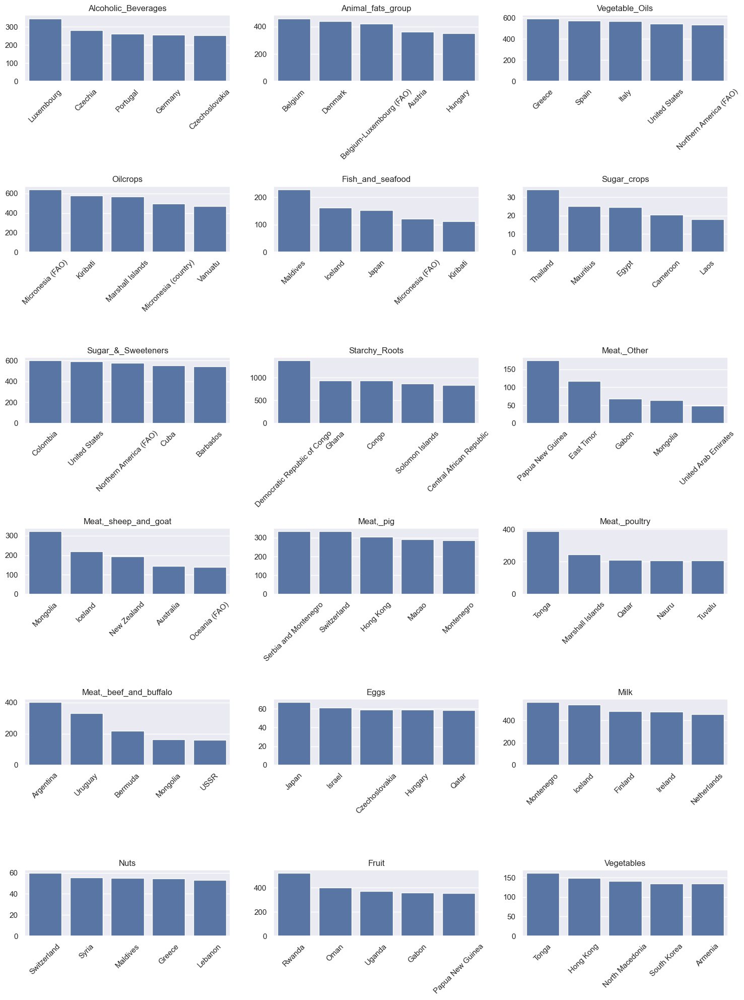

In [583]:
nrows=6
ncols=3
fig,axes=plt.subplots(nrows,ncols,figsize=(15,20))        
for i in range(nrows):
     for j in range(ncols):
        df_max=df.groupby("Entity")[df.columns[4+(i*ncols)+j]].mean().sort_values(ascending=False).reset_index(name=col).head(5)
        sns.barplot(df_max,x="Entity",y=df_max.columns[1],ax=axes[i,j])
        axes[i,j].tick_params(axis='x', rotation=45)
        axes[i,j].set_title(df.columns[4+(i*ncols)+j])
        axes[i,j].set_ylabel("")
        axes[i,j].set_xlabel("")

plt.tight_layout()
plt.show()
    

In [ ]:
# Verteilung der Kategorien

In [376]:
cols_to_melt = df.columns[4:-1]

df_long = df.melt(value_vars=cols_to_melt, # Die Spalten, die zu Werten werden sollen
                  id_vars=['Entity', 'Year'],# Spalten als indentifikator  behalten 
                  var_name="Kategorie",    # Name der neuen Spalte für die Spaltennamen
                  value_name="Wert")       # Name der neuen Spalte für die Werte



In [378]:
df_long.head()

,Entity,Year,Kategorie,Wert
0,Afghanistan,1961,Alcoholic_Beverages,0.0
1,Afghanistan,1962,Alcoholic_Beverages,0.0
2,Afghanistan,1963,Alcoholic_Beverages,0.0
3,Afghanistan,1964,Alcoholic_Beverages,0.0
4,Afghanistan,1965,Alcoholic_Beverages,0.0


In [442]:
countries=df_long["Entity"].unique()[:]

fig = px.box(df_long[df_long["Entity"].isin(countries)],
             x="Kategorie",      
             y="Wert",           
             title="Verteilung der Werte pro Kategorie")#),color="Entity")
fig.show()

In [625]:
print(df.columns)

year=[1964,2022]
fig = px.histogram(df[df["Year"].isin(year)],
             x="Sugar_&_Sweeteners",histnorm='percent',nbins=20,color="Year",barmode='overlay')   
fig.show()

Index(['Entity', 'Code', 'Year', 'Miscellaneous_group', 'Alcoholic_Beverages',
       'Animal_fats_group', 'Vegetable_Oils', 'Oilcrops', 'Fish_and_seafood',
       'Sugar_crops', 'Sugar_&_Sweeteners', 'Starchy_Roots', 'Meat,_Other',
       'Meat,_sheep_and_goat', 'Meat,_pig', 'Meat,_poultry',
       'Meat,_beef_and_buffalo', 'Eggs', 'Milk', 'Nuts', 'Fruit', 'Vegetables',
       'Pulses', 'Cereals,_other', 'Barley', 'Maize', 'Rice', 'Wheat',
       'total'],
      dtype='object')


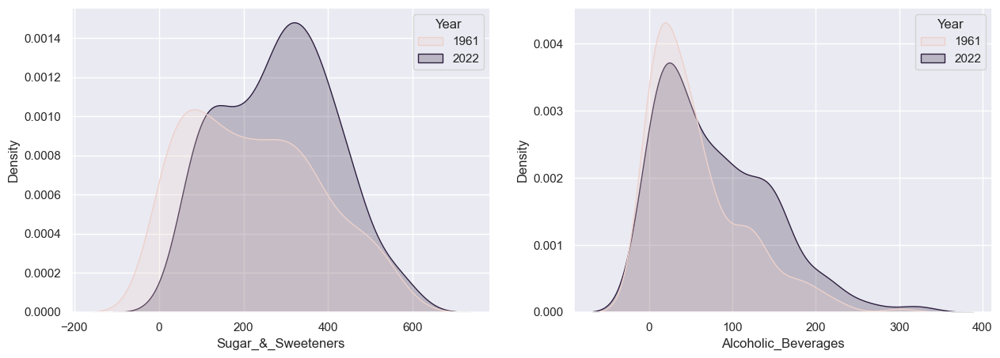

In [673]:
year=[1961,2022]

fig,ax=plt.subplots(1,2,figsize=(15,5))
sns.kdeplot(df[df["Year"].isin(year)],
             x="Sugar_&_Sweeteners",hue="Year",fill=True,ax=ax[0])
sns.kdeplot(df[df["Year"].isin(year)],
             x="Alcoholic_Beverages",hue="Year",fill=True,ax=ax[1])
plt.show()

In [661]:
df.columns

Index(['Entity', 'Code', 'Year', 'Miscellaneous_group', 'Alcoholic_Beverages',
       'Animal_fats_group', 'Vegetable_Oils', 'Oilcrops', 'Fish_and_seafood',
       'Sugar_crops', 'Sugar_&_Sweeteners', 'Starchy_Roots', 'Meat,_Other',
       'Meat,_sheep_and_goat', 'Meat,_pig', 'Meat,_poultry',
       'Meat,_beef_and_buffalo', 'Eggs', 'Milk', 'Nuts', 'Fruit', 'Vegetables',
       'Pulses', 'Cereals,_other', 'Barley', 'Maize', 'Rice', 'Wheat',
       'total'],
      dtype='object')

In [665]:
year=[1961,2022]
cat=['Vegetable_Oils','Sugar_&_Sweeteners','Meat,_beef_and_buffalo','Vegetables']

df_long_filtered=df_long[(df_long["Year"].isin(year))&(df_long["Kategorie"].isin(cat))]
fig=px.box(df_long_filtered,
             y="Wert",x="Year",color="Kategorie",points=False)# points --> Ausreißer ausgeschaltet
fig.show()

In [454]:
countries=df["Entity"].unique()[10:15]

<Axes: xlabel='Year', ylabel='total'>

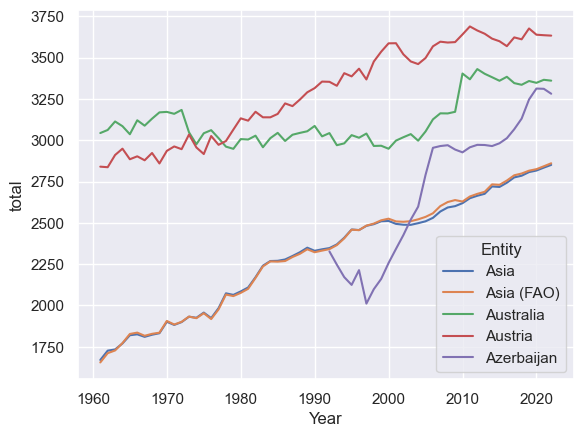

In [456]:
sns.lineplot(df[df["Entity"].isin(countries)],x="Year",y="total",hue="Entity")

In [202]:
df_agg=df.groupby("Entity").agg({col:["median"] for col in df.columns[4::]}).sort_values(by=("Alcoholic_Beverages","median"),ascending=False).head(10)
df_agg

,Alcoholic_Beverages,Animal_fats_group,Vegetable_Oils,Oilcrops,Fish_and_seafood,Sugar_crops,Sugar_&_Sweeteners,Starchy_Roots,"Meat,_Other","Meat,_sheep_and_goat",...,Nuts,Fruit,Vegetables,Pulses,"Cereals,_other",Barley,Maize,Rice,Wheat,total
,median,median,median,median,median,median,median,median,median,median,...,median,median,median,median,median,median,median,median,median,median
Entity,,,,,,,,,,,,,,,,,,,,,
Luxembourg,345.052460,95.722430,297.023700,19.726965,46.563507,NaN,290.77066,78.485590,6.878359,10.936597,...,4.778860,148.620620,77.075520,9.975463,14.255913,14.093654,36.317226,41.293690,748.315500,3233.708378
Czechia,284.037485,194.518920,480.997390,23.871011,19.101015,NaN,386.46651,135.053365,12.534112,1.798386,...,13.891757,83.802980,55.273404,18.050727,7.229484,0.892743,0.000000,44.003903,710.425230,3128.979231
Czechoslovakia,266.124240,307.162735,233.416470,4.979355,15.007831,NaN,437.16501,172.359265,7.381805,2.029038,...,11.166928,70.452285,48.982537,11.927874,1.989860,NaN,NaN,45.434897,818.968000,3143.862043
Estonia,265.887180,119.177830,200.106380,5.876007,22.542892,NaN,350.63742,184.258560,0.820144,2.570695,...,18.191578,91.917060,65.332540,28.606142,13.991795,51.117540,42.340225,24.712406,533.381400,2847.470980
Portugal,265.240815,165.212640,419.586245,10.969742,80.626582,NaN,265.36038,173.028570,3.795871,16.671841,...,23.327049,129.955905,89.141572,41.278423,0.863603,5.845490,117.750248,148.136165,668.007650,3291.531259
Germany,255.716265,322.685195,375.259875,25.825102,26.624736,0.0,427.26912,146.365485,4.131816,5.233991,...,34.767312,123.551918,55.173304,9.069392,6.207514,2.408488,49.661406,23.968799,521.774415,3172.110419
Austria,241.798300,349.026185,437.063120,24.085460,20.031200,NaN,418.67207,112.238050,3.000532,6.125435,...,35.266266,149.110425,52.788547,7.095595,0.000000,2.357032,38.137964,35.858345,560.934900,3341.222177
Belgium-Luxembourg (FAO),229.000000,413.000000,358.000000,7.000000,29.000000,NaN,359.00000,197.000000,14.330000,11.070000,...,18.790000,99.000000,69.000000,25.000000,10.630000,0.920000,12.390000,35.710000,675.540000,3217.940000
